In [1]:
# data management
import pandas as pd
from scipy.io import mmread
from scipy.io import mmwrite
from scipy.sparse import csr_matrix
import scanpy as sc
import anndata as ad
import pickle
import numpy as np

# analysis
import scvelo as scv
import cellrank as cr

scv.settings.set_figure_params("scvelo")
ncores = 32

Load data

In [2]:
pal_data = sc.read_h5ad("../data/processed/velocity_results/pal_data_raw.h5ad")

In [3]:
original_counts = csr_matrix(mmread("../data/processed/ax_regions_data.mtx"))
original_meta = pd.read_csv("../data/processed/ax_regions_meta.csv", index_col = 0)
newnames = [x.replace("-1_1_5", "_D1") for x in original_meta.index.values]
newnames = [x.replace("-1_2_5", "_D2") for x in newnames]
newnames = [x.replace("-1_3_5", "_L1") for x in newnames]
newnames = [x.replace("-1_4_5", "_L2") for x in newnames]
newnames = [x.replace("-1_5_5", "_M1") for x in newnames]
newnames = [x.replace("-1_6_5", "_M2") for x in newnames]

newnames = [x.replace("-1_1", "_a1_1") for x in newnames]
newnames = [x.replace("-1_2", "_a1_2") for x in newnames]
newnames = [x.replace("-1_3", "_a3_1") for x in newnames]
newnames = [x.replace("-1_4", "_a3_2") for x in newnames]

original_meta.index = newnames

original_genes = pd.read_csv("../data/processed/ax_regions_genes.csv", index_col = 0)

In [4]:
keep = pd.Series(original_genes.index.isin(pal_data.var.index.values))
keep = keep[keep].index.values
original_counts = original_counts[:,keep]
original_genes = original_genes.iloc[keep,:]

In [5]:
pal_data = pal_data[original_meta.index.values,original_genes.index.values]

pal_or_data = ad.AnnData(original_counts, obs=pal_data.obs, var = pal_data.var)
pal_or_data.layers["spliced"] = pal_data.layers["spliced"]
pal_or_data.layers["unspliced"] = pal_data.layers["unspliced"]

In [6]:
pal_or_data.obs.cellclusters.value_counts()

glut_SUBSET_0      3883
glut_SUBSET_1      3553
GABA_SUBSET_0      3293
glut_SUBSET_2      3235
GABA_SUBSET_1      2935
glut_SUBSET_3      2925
glut_SUBSET_4      2750
GABA_SUBSET_2      2606
glut_SUBSET_5      2551
glut_SUBSET_6      2329
GABA_SUBSET_3      1821
glut_SUBSET_7      1528
GABA_SUBSET_4      1510
GABA_SUBSET_5      1450
GABA_SUBSET_6       994
glut_SUBSET_8       961
ependymal_0         848
glut_SUBSET_9       845
GABA_SUBSET_7       833
GABA_SUBSET_8       717
glut_SUBSET_10      668
ependymal_1         636
GABA_SUBSET_9       525
ependymal_2         447
ependymal_3         430
ependymal_4         386
ependymal_5         368
endothelial         303
microglia           273
GABA_SUBSET_10      262
ependymal_6         249
neuro_26            240
npc_SUBSET_0        221
glut_SUBSET_11      204
oligodendrocyte     201
npc_SUBSET_1        171
npc_SUBSET_2        158
npc_SUBSET_3        151
npc_SUBSET_4        135
npc_SUBSET_5        121
npc_SUBSET_6        117
npc_SUBSET_7    

Subset data

In [7]:
keep1 = np.logical_or(np.logical_or(pal_or_data.obs["cellclusters"].str.startswith("npc"), 
                                   pal_or_data.obs["cellclusters"].str.startswith("ependymal")),
                    pal_or_data.obs["cellclusters"].str.startswith("glut"))
keep2 = [not x in ["npc_SUBSET_2", "npc_SUBSET_7", "npc_SUBSET_8", "npc_SUBSET_9", 
                   "npc_SUBSET_10", "glut_SUBSET_9", "glut_SUBSET_10"] for x in pal_or_data.obs["cellclusters"]]
keep = np.logical_and(keep1, keep2)
sub_pal_data = pal_or_data[keep,]
# change X
sub_pal_data._X = sub_pal_data.X # somehow this is necessary
sub_pal_data.shape

(28279, 82958)

In [8]:
sub_pal_data.obs["all_reg_pred_top"].unique()

['dorsal_pred', 'medial_pred', 'other/unknown_pred', 'lateral_pred', 'dorsal', 'lateral', 'medial']
Categories (7, object): ['dorsal', 'dorsal_pred', 'lateral', 'lateral_pred', 'medial', 'medial_pred', 'other/unknown_pred']

In [9]:
scv.pp.filter_genes(sub_pal_data, min_shared_counts=20)
scv.pp.normalize_per_cell(sub_pal_data, enforce=True)
scv.pp.filter_genes_dispersion(sub_pal_data, n_top_genes=5000)
scv.pp.log1p(sub_pal_data)
sub_pal_data.obs["chem_int"] = pd.Categorical(sub_pal_data.obs["chem"]).codes
sc.pp.regress_out(sub_pal_data, keys=["n_counts","initial_size","chem_int"])

Trying to set attribute `.obs` of view, copying.


Filtered out 71626 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 5000 highly variable genes.


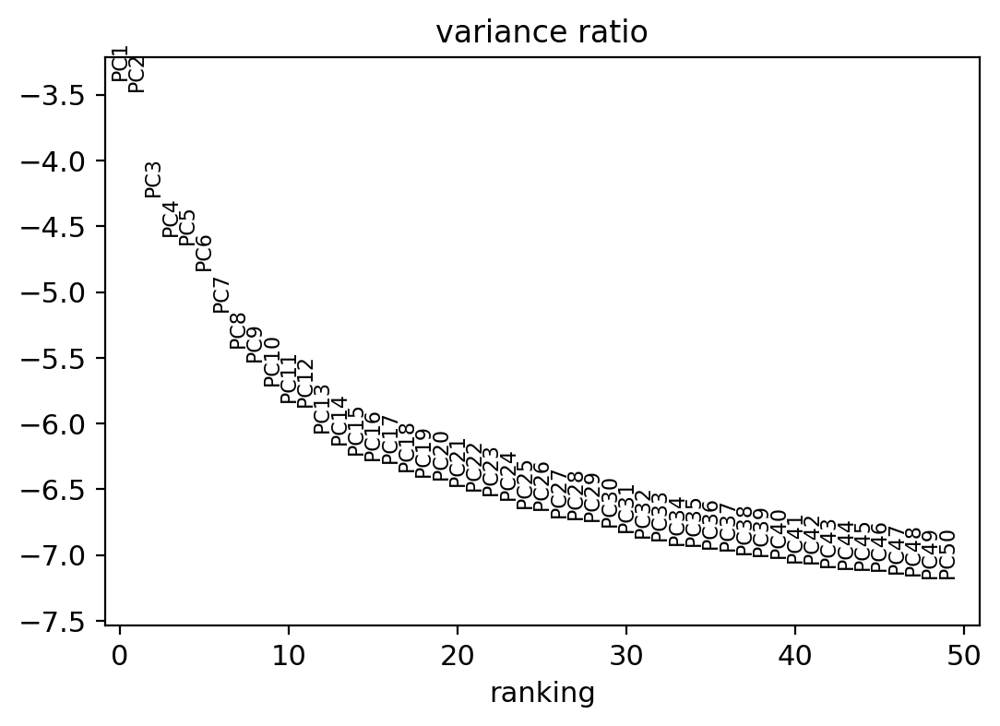

In [10]:
sc.tl.pca(sub_pal_data, n_comps = 50, svd_solver='arpack')
sc.pl.pca_variance_ratio(sub_pal_data, n_pcs=50, log=True)

In [11]:
sc.external.pp.bbknn(sub_pal_data, batch_key = "chem", neighbors_within_batch=10, n_pcs=30)
sc.tl.leiden(sub_pal_data, resolution=0.7, key_added="leiden_07")
sc.tl.leiden(sub_pal_data, resolution=5, key_added="leiden_5")
sc.tl.leiden(sub_pal_data, resolution=10, key_added="leiden_10")
sc.tl.leiden(sub_pal_data, resolution=20, key_added="leiden_20")
sc.tl.leiden(sub_pal_data, resolution=25, key_added="leiden_25")

In [12]:
sc.tl.umap(sub_pal_data)

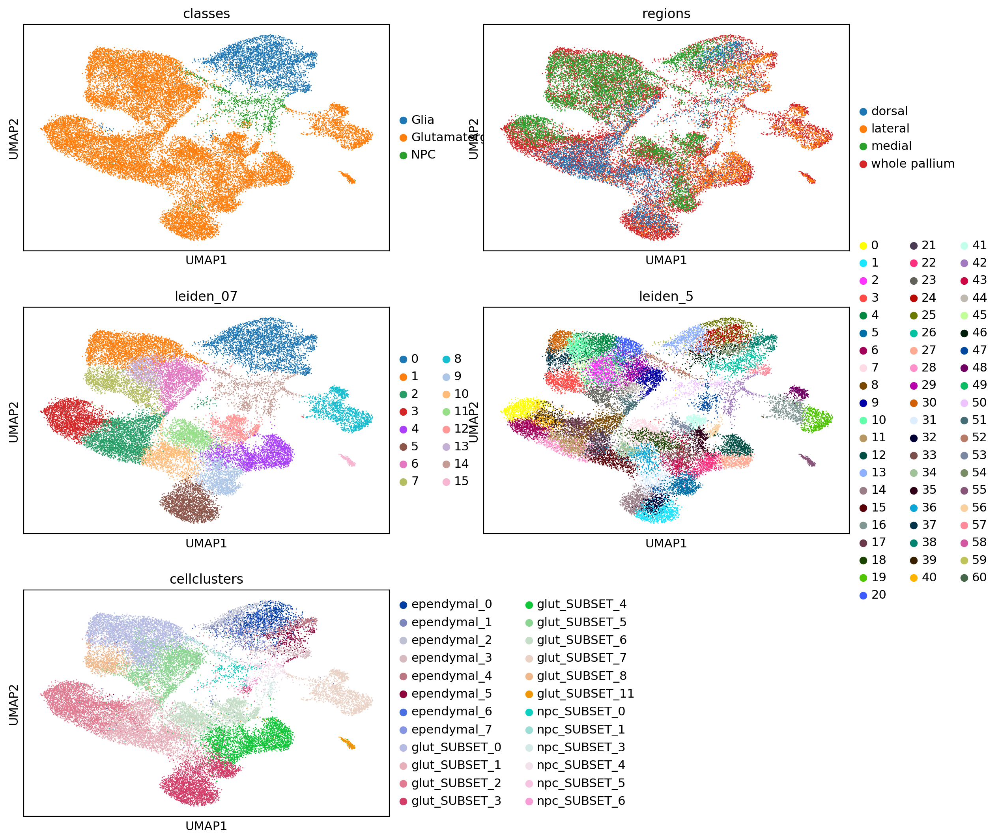

In [13]:
sc.pl.umap(sub_pal_data, color=["classes","regions","leiden_07","leiden_5", "cellclusters"], ncols = 2)

Calculate moments

In [14]:
scv.pp.moments(sub_pal_data, n_pcs=30, n_neighbors=30)

computing neighbors
    finished (0:00:18) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:15) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


Recover dynamics

In [ ]:
scv.tl.recover_dynamics(sub_pal_data, n_jobs = ncores, max_iter = 500, fit_connected_states = True, fit_basal_transcription = True) # plot_results, use_raw

recovering dynamics (using 32/50 cores)


  0%|          | 0/825 [00:00<?, ?gene/s]

Get velocity estimates

In [ ]:
scv.tl.velocity(sub_pal_data, mode="dynamical")
scv.tl.velocity_graph(sub_pal_data, n_jobs = ncores)

Plot velocity streams

In [ ]:
scv.pl.velocity_embedding_stream(sub_pal_data, basis='umap', color=["classes","sample","leiden_07","cellclusters"], 
                                 ncols = 2, figsize = [8,8])

Calculate latent time from velocity streams

In [ ]:
scv.tl.latent_time(sub_pal_data)
scv.pl.scatter(sub_pal_data, color='latent_time', color_map='gnuplot', size=80, colorbar=True, figsize=[7,7])

Plot genes illustrating the 3 major branches

In [ ]:
scv.pl.velocity(sub_pal_data, ['GAD2', 'SLC17A6', "HES6", "MEX3A"], ncols=1, figsize = [7,7], color="classes")

Infer cell cycle stage

In [ ]:
scv.tl.score_genes_cell_cycle(sub_pal_data)
scv.pl.scatter(sub_pal_data, color_gradients=['S_score', 'G2M_score'], smooth=True, perc=[10, 90])
scv.pl.scatter(sub_pal_data, color=['phase'])

In [ ]:
scv.tl.velocity_confidence(sub_pal_data)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(sub_pal_data, c=keys, cmap='coolwarm', perc=[5, 95])

Velocity by cluster

In [ ]:
df = sub_pal_data.obs.groupby('cellclusters')[keys].mean().T
df.style.background_gradient(cmap='coolwarm', axis=1)

Plot velocity graph

In [ ]:
scv.pl.velocity_graph(sub_pal_data, threshold=.2)

Plot cell transitions

In [ ]:
starting_cell = sub_pal_data.obs.sort_values("latent_time").index.values[0]
x, y = scv.utils.get_cell_transitions(sub_pal_data, basis='umap', starting_cell=starting_cell)
ax = scv.pl.velocity_graph(sub_pal_data, c='lightgrey', edge_width=.05, show=False)
ax = scv.pl.scatter(sub_pal_data, x=x, y=y, s=120, c='ascending', cmap='gnuplot', ax=ax)

Get velocity pseudotime (graph-based)

In [ ]:
starting_cell = sub_pal_data.obs.sort_values("latent_time").index.values[0]
scv.tl.velocity_pseudotime(sub_pal_data, n_dcs=30, root_key=starting_cell)
scv.pl.scatter(sub_pal_data, color='velocity_pseudotime', cmap='gnuplot')

Get terminal states - scVelo

In [ ]:
scv.tl.terminal_states(sub_pal_data)
scv.pl.scatter(sub_pal_data, color=['root_cells', 'end_points'], figsize = [7,7])

Generate PAGA

In [ ]:
# this is needed due to a current bug - bugfix is coming soon.
sub_pal_data.uns['neighbors']['distances'] = sub_pal_data.obsp['distances']
sub_pal_data.uns['neighbors']['connectivities'] = sub_pal_data.obsp['connectivities']

scv.tl.paga(sub_pal_data, groups='leiden_25', use_time_prior="latent_time", 
            minimum_spanning_tree=True, threshold_root_end_prior=0.9)
df = scv.get_df(sub_pal_data, 'paga/transitions_confidence', precision=2).T
#df.style.background_gradient(cmap='Blues').format('{:.2g}')

Plot PAGA

In [ ]:
scv.pl.paga(sub_pal_data, basis='umap', size=50, alpha=.1, 
            min_edge_width=2, node_size_scale=1.5, figsize = [8,8])

In [ ]:
vk = cr.tl.kernels.VelocityKernel(sub_pal_data).compute_transition_matrix()
ck = cr.tl.kernels.ConnectivityKernel(sub_pal_data).compute_transition_matrix()
cvk = 0.75*vk+0.25*ck
g = cr.tl.estimators.GPCCA(cvk)
g.compute_schur(n_components=12)

Select end point cells

In [ ]:
scv.pl.umap(sub_pal_data, color="leiden_25", add_outline=True, figsize=[30,30])

In [ ]:
end_clusters = ["9", "4", "30", "0", "22", "19", "3", "74", "12", "40", "49", "8", "204", "194", "14", "29"]
dict_top_ends = {}
for x in end_clusters:
    subdat = sub_pal_data.obs.loc[sub_pal_data.obs["leiden_25"]==x,["latent_time", "end_points"]].sort_values(["end_points","latent_time"], ascending=[False,False])
    dict_top_ends[x] = subdat.head(30).index.values

Define the terminal states and compute absorption probabilities

In [77]:
g.set_terminal_states(labels=dict_top_ends, cluster_key="leiden_25")
g.compute_absorption_probabilities()

  0%|          | 0/16 [00:00<?, ?/s]

/home/tpires/bin/miniconda3/envs/scgen-env/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


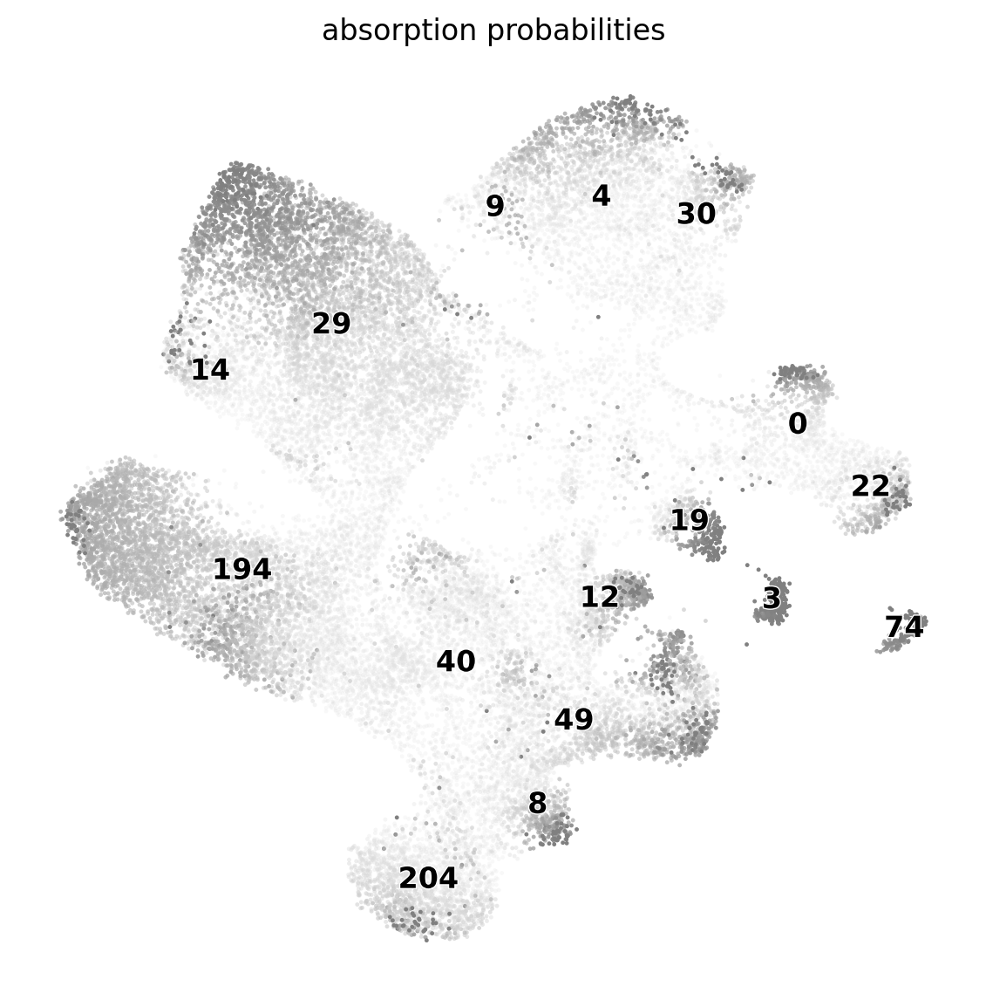

In [78]:
g.plot_absorption_probabilities(figsize=[7,7])

/home/tpires/bin/miniconda3/envs/scgen-env/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


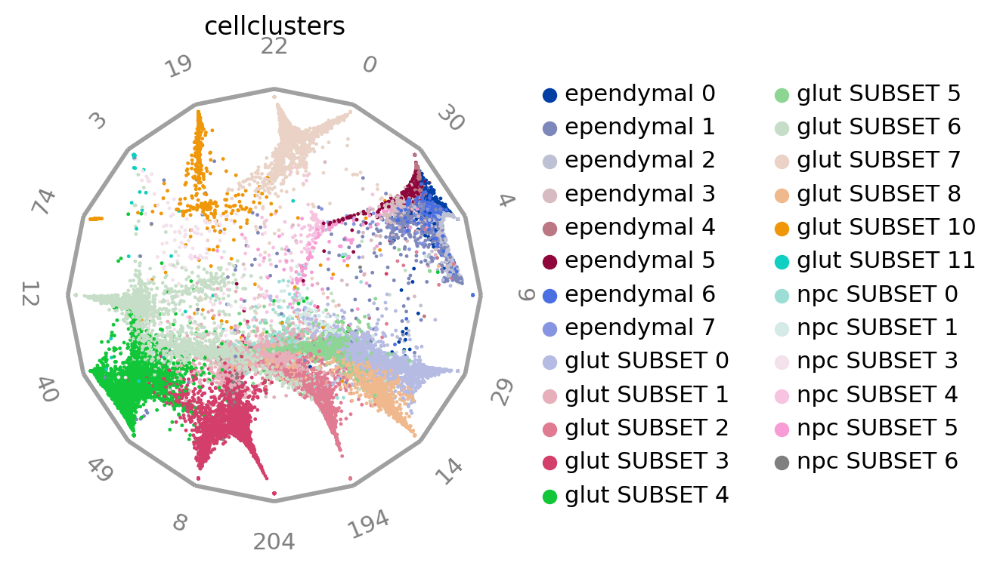

In [79]:
cr.pl.circular_projection(sub_pal_data, keys="cellclusters", lineages=end_clusters, 
                          lineage_order="default", legend_loc="right")

Compute drivers for all lineages

/home/tpires/bin/miniconda3/envs/scgen-env/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


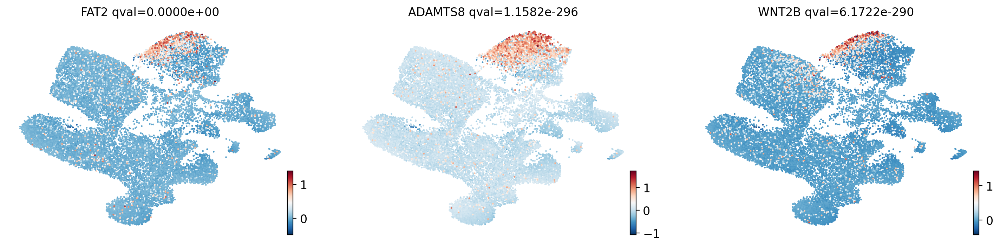

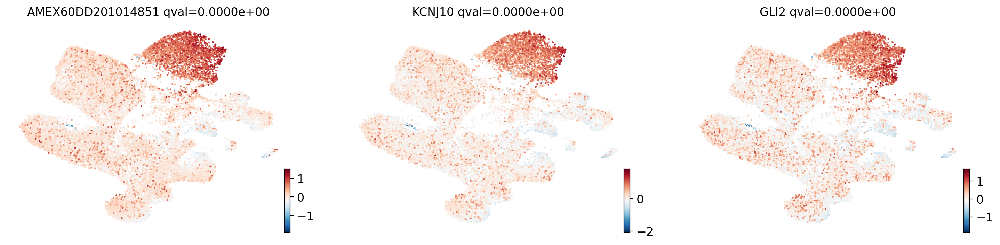

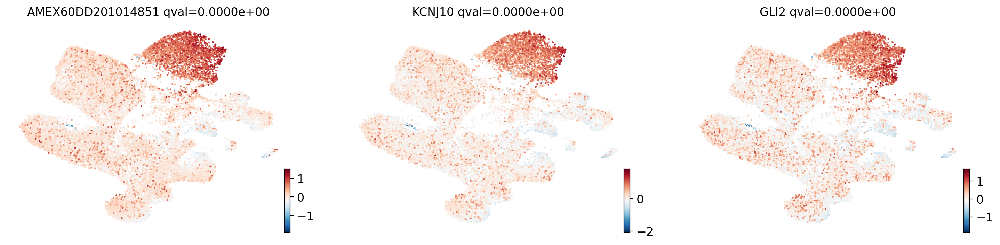

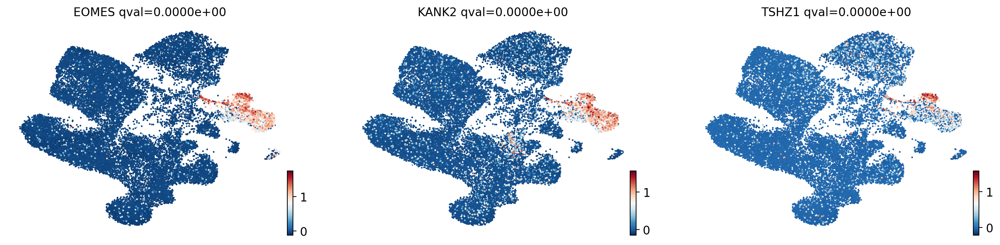

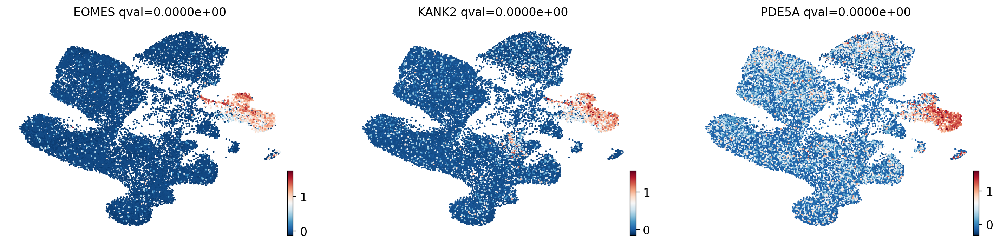

...

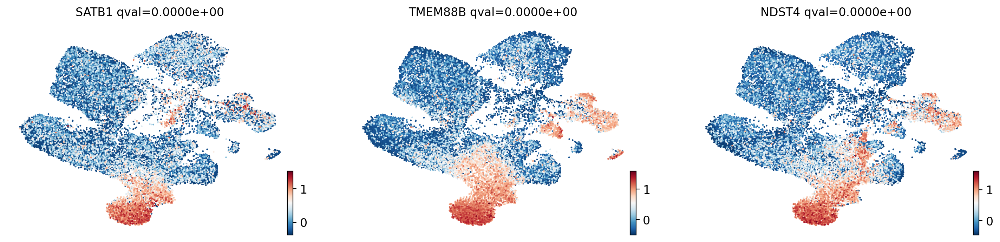

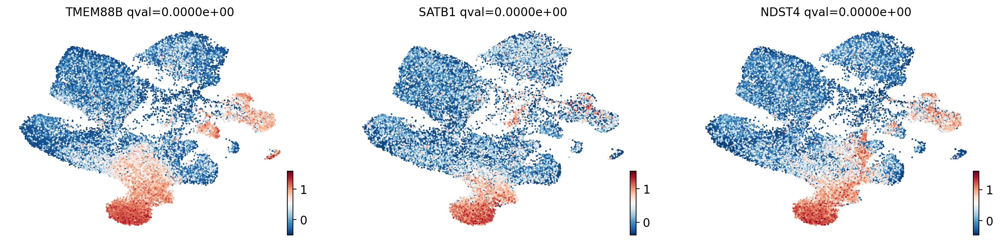

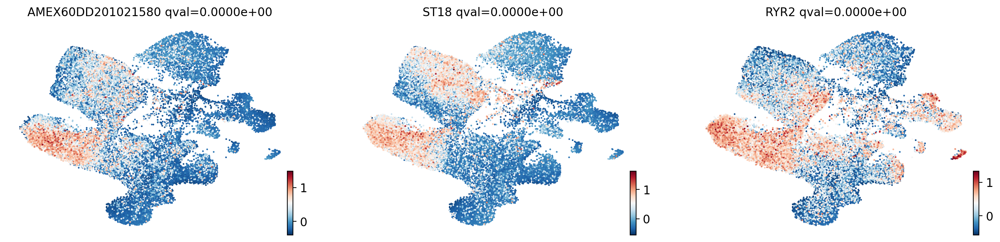

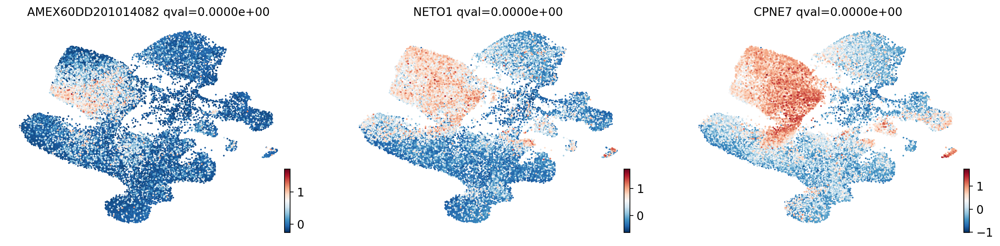

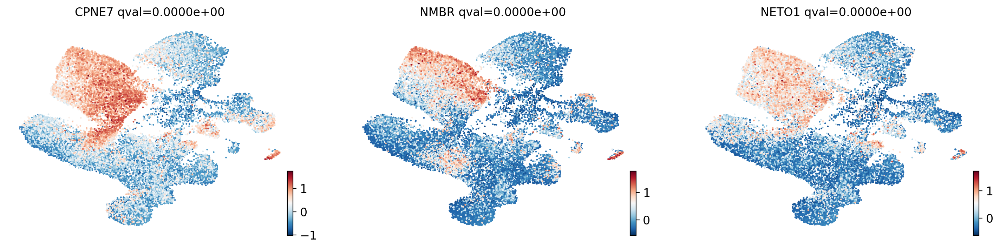

In [80]:
all_drivers = g.compute_lineage_drivers(lineages=end_clusters, return_drivers=True)
for l in end_clusters:
    g.plot_lineage_drivers(l, n_genes=3)

Compute markers for all Leiden 25 clusters

In [58]:
sc.tl.rank_genes_groups(sub_pal_data, groupby='leiden_25', method='wilcoxon')
result = sub_pal_data.uns['rank_genes_groups']
groups = result['names'].dtype.names
de_res = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})

/home/tpires/bin/miniconda3/envs/scgen-env/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Start estimator for starting states

In [60]:
vk = cr.tl.kernels.VelocityKernel(sub_pal_data, backward=True).compute_transition_matrix()
ck = cr.tl.kernels.ConnectivityKernel(sub_pal_data, backward=True).compute_transition_matrix()
cvk = 0.75*vk+0.25*ck
gi = cr.tl.estimators.GPCCA(cvk)
gi.compute_schur(n_components=5)

  0%|          | 0/28947 [00:00<?, ?cell/s]

  0%|          | 0/28947 [00:00<?, ?cell/s]

Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000175e+00 -3.0158670613490739e-04 -1.9686171566967235e-03 -9.0495139083934069e-04 -8.2023854777274886e-04 1.3693938617989319e-03 -2.3624294560143011e-03 
0.0000000000000000e+00 9.9453635006460150e-01 -8.8418301412687000e-04 -1.2638178375579565e-04 -1.8592454178161934e-03 1.4129266384019293e-03 3.6278619339903337e-04 
0.0000000000000000e+00 0.0000000000000000e+00 9.9199637557638043e-01 1.2652897082496907e-04 2.2327935558078595e-04 -5.8027581232799480e-04 3.5565946530219047e-04 
0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 9.9172124401793915e-01 5.8236972303720911e-04 -2.1469424475017564e-04 -3.6987673205845644e-04 
0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 9.9036222006036578e-01 -1.3399693979871695e-04 9.4924982550336477e-05 
0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 9.8985451400336766

Select start point cells

In [61]:
st_clusters = ["146"]
dict_top_sts = {}
for x in st_clusters:
    subdat = sub_pal_data.obs.loc[sub_pal_data.obs["leiden_25"]==x,["latent_time", "root_cells"]].sort_values(["root_cells","latent_time"], ascending=[False,True])
    dict_top_sts[x] = subdat.head(30).index.values

/home/tpires/bin/miniconda3/envs/scgen-env/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Set initial states and compute absorption probabilities

In [62]:
gi.set_terminal_states(labels=dict_top_sts, cluster_key="leiden_25")
gi.compute_absorption_probabilities()

  0%|          | 0/1 [00:00<?, ?/s]

/home/tpires/bin/miniconda3/envs/scgen-env/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


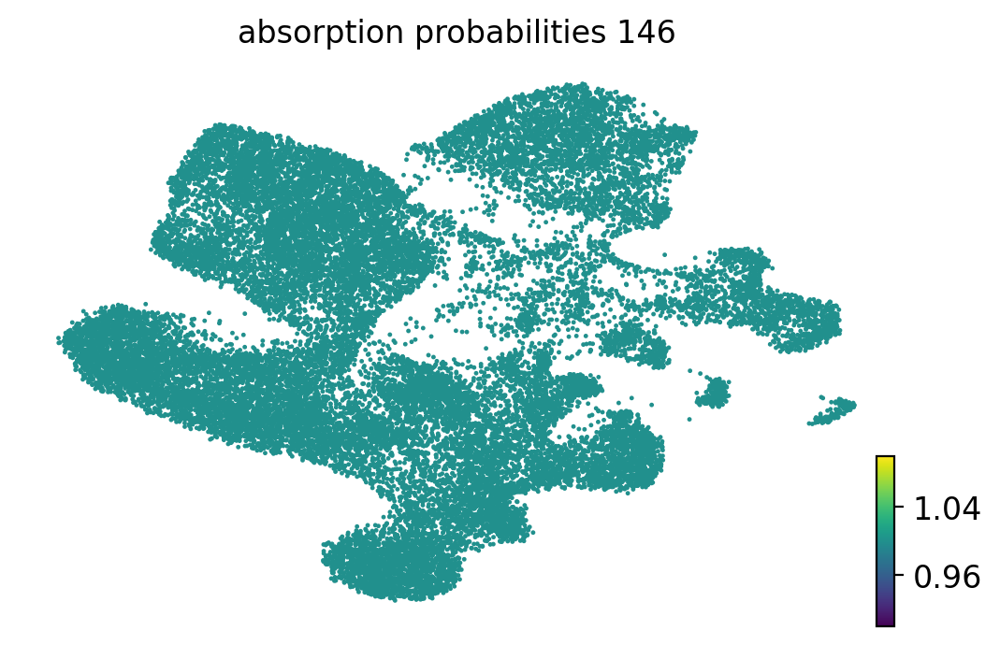

In [63]:
gi.plot_absorption_probabilities()

Compute new PAGA

In [81]:
scv.tl.paga(sub_pal_data, groups="leiden_25", root_key="initial_states_probs", end_key="terminal_states_probs", 
            use_time_prior="latent_time", minimum_spanning_tree=False, threshold_root_end_prior=0.98)

/home/tpires/bin/miniconda3/envs/scgen-env/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


running PAGA using priors: ['latent_time']
    finished (0:00:17) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


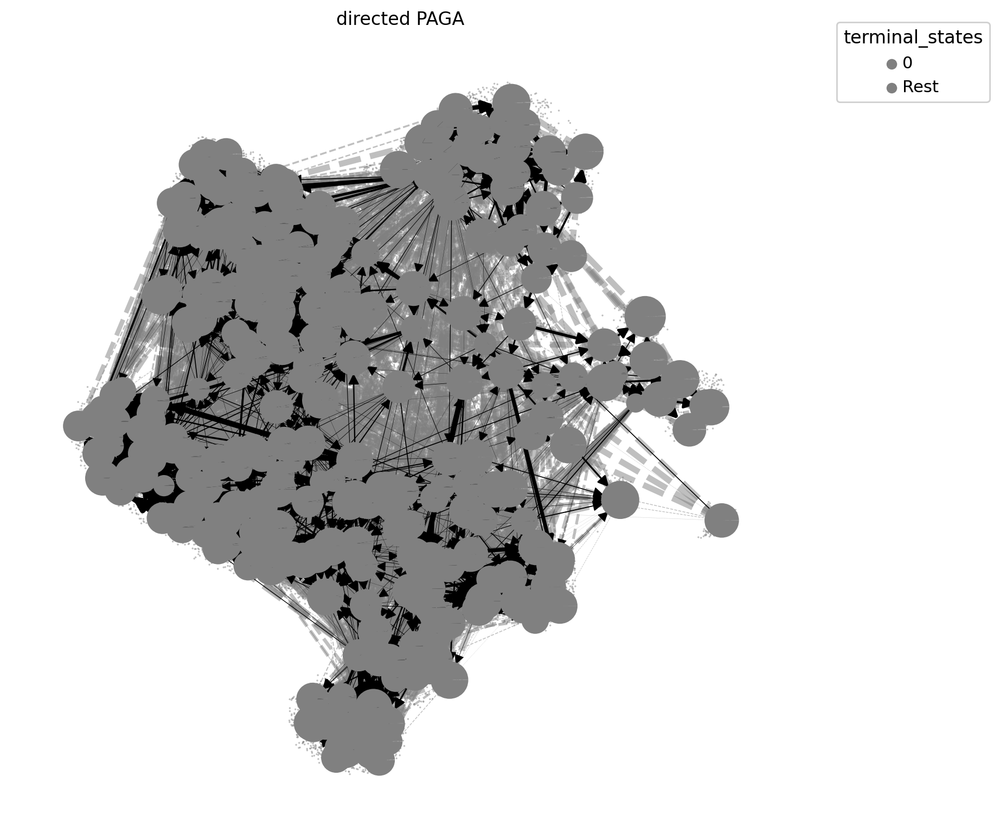

In [82]:
cr.pl.cluster_fates(sub_pal_data,mode="paga_pie",cluster_key="leiden_25",basis="umap",legend_kwargs={"loc": "top right out"},
                    legend_loc=None,node_size_scale=5,edge_width_scale=1,max_edge_width=4,title="directed PAGA",figsize=[8,8])

In [108]:
model = cr.ul.models.GAM(sub_pal_data)
cr.pl.gene_trends(sub_pal_data,model=model,data_key="X",genes=["GLI2","MEX3A","EOMES"],ncols=4,
                  time_key="latent_time",same_plot=True,hide_cells=True,figsize=(15, 4),n_test_points=200)

/home/tpires/bin/miniconda3/envs/scgen-env/lib/python3.9/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


  0%|          | 0/3 [00:00<?, ?gene/s]

RuntimeError: Fatal model failure `<FailedModel[origin=GAM[gene='GLI2', lineage='12', model=GammaGAM(callbacks=[Deviance(), Diffs()], fit_intercept=True, max_iter=2000, scale=None, terms=s(0), tol=0.0001, verbose=False)]]>`.

Save necessary data

In [83]:
# metadata
sub_pal_data.obs.to_csv("../data/processed/velocity_results/glut_ss_pal_obs.csv")
# umap coordinates
umap = pd.DataFrame(sub_pal_data.obsm["X_umap"], columns = ["UMAP_1","UMAP_2"], 
                    index = sub_pal_data.obs.index.values).to_csv("../data/processed/velocity_results/glut_ss_pal_umap.csv")
# circular coordinates
circ = pd.DataFrame(sub_pal_data.obsm["X_fate_simplex_fwd"], columns = ["fate_1","fate_2"], 
                    index = sub_pal_data.obs.index.values).to_csv("../data/processed/velocity_results/glut_ss_pal_circ.csv")
# genes
sub_pal_data.var.to_csv("../data/processed/velocity_results/glut_ss_pal_var.csv")
# absorption probabilities
abs_prob = pd.DataFrame(sub_pal_data.obsm["to_terminal_states"], columns = sub_pal_data.obsm["to_terminal_states"].names, 
                        index = sub_pal_data.obs.index.values).to_csv("../data/processed/velocity_results/glut_ss_pal_abs_prob.csv")
# expression matrix
#mmwrite(target="../data/processed/velocity_results/glut_ss_pal_X.mtx", a=sub_pal_data.X)
pd.DataFrame(sub_pal_data.X, index = sub_pal_data.obs.index.values, columns = sub_pal_data.var.index.values).to_csv("../data/processed/velocity_results/glut_ss_pal_X.csv")
# paga
for k in ["connectivities","connectivities_tree",
          "transitions_confidence","pos"]:
    if k!="pos":
        pd.DataFrame(sub_pal_data.uns["paga"][k].todense()).to_csv("../data/processed/velocity_results/glut_ss_pal_paga_"+k+".csv")
    else:
        pd.DataFrame(sub_pal_data.uns["paga"][k]).to_csv("../data/processed/velocity_results/glut_ss_pal_paga_"+k+".csv")
# lineage genes
all_drivers.to_csv("../data/processed/velocity_results/glut_ss_pal_lineageDrivers.csv")
# marker genes
de_res.to_csv("../data/processed/velocity_results/glut_ss_pal_markersLeiden25.csv")

In [84]:
sub_pal_data.write_h5ad("../data/processed/velocity_results/glut_ss_pal.h5ad")